# Advanced Lane Finding

**Advanced Lane Finding Project**

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## 1. Camera Calibration

### 1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.

The code for this step is contained in the first code cell of the IPython notebook located in "./examples/example.ipynb" (or in lines # through # of the file called `some_file.py`).  

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.  

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function.  I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained this result: 

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

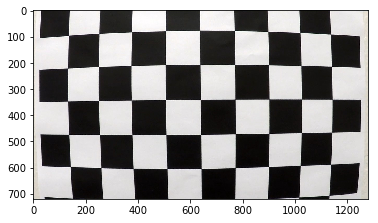

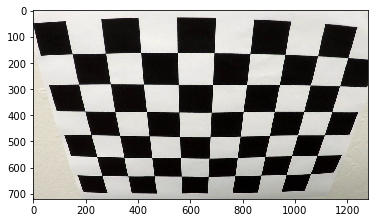

In [2]:
# Read in one of the calibration image and show
correct_1 = mpimg.imread('camera_cal/calibration1.jpg')
plt.imshow(correct_1)
plt.show()
correct_2 = mpimg.imread('camera_cal/calibration2.jpg')
plt.imshow(correct_2)
plt.show()

We can see that these chessboards have 9x6 shapes, next we'll use these parameters to calibrate camera

### 1.1 Find object points and image points to calibrate camera ###

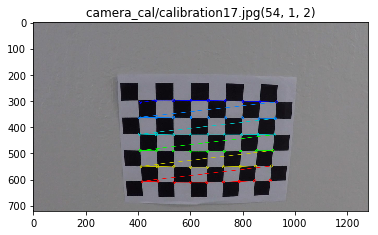

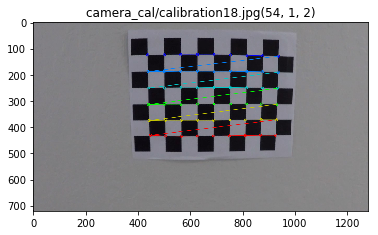

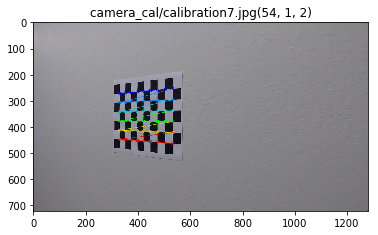

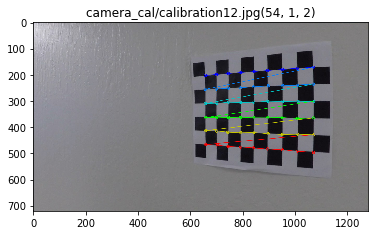

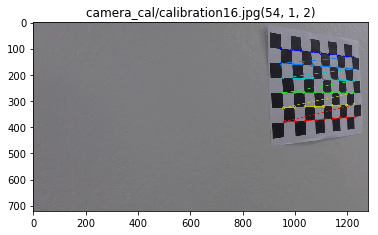

...

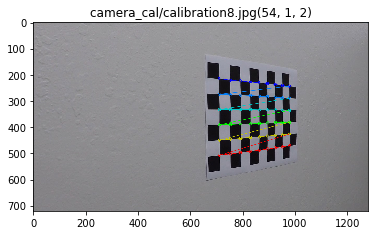

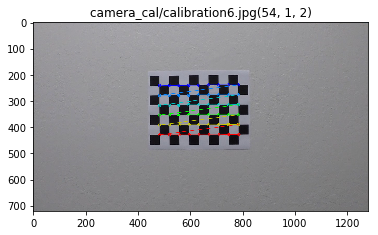

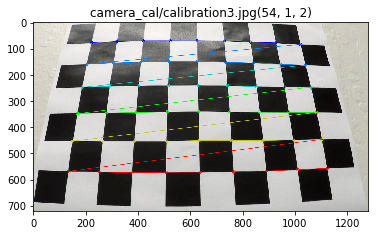

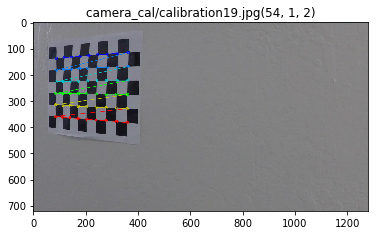

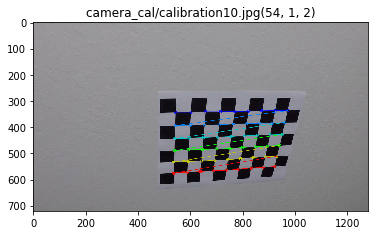

In [32]:
import glob
# %matplotlib qt

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# print(len(images))

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# # arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# # prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)
    cv2.drawChessboardCorners(image, chessboard_dim, corners, ret)
    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        # draw and display corners for last image
        img = cv2.drawChessboardCorners(image, chessboard_dim,corners,ret)
        plt.imshow(img)
        objpn = np.array(corners)
        plt.title(frame+str(objpn.shape))
        plt.show()

### 1.2 Use the object points and image points found above to calibrate camera ###

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimgundist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # convert to grayscale image
    gray = cv2.cvtColor(u# takes an image, object points, and image points
# performs the camera calibration, image distortion correction and 
# returns the undistorted image
def cal_undistort(image):
    img = np.copy(image)
    undist = img
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)
    img = cv2.drawChessboardCorners(img, chessboard_dim, corners, ret)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist,retb

for image in images:    
    test_img = mpimg.imread(image)
    undistorted,ret = cal_undistort(test_img)
    if not ret:
        print('image:{} is not processed'.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 9))
    f.tight_layout()
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=12)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=12)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

** We can see that all test images are well undistorted, so we can proceed to next step. **

### 1.3  Transform image perspective ###

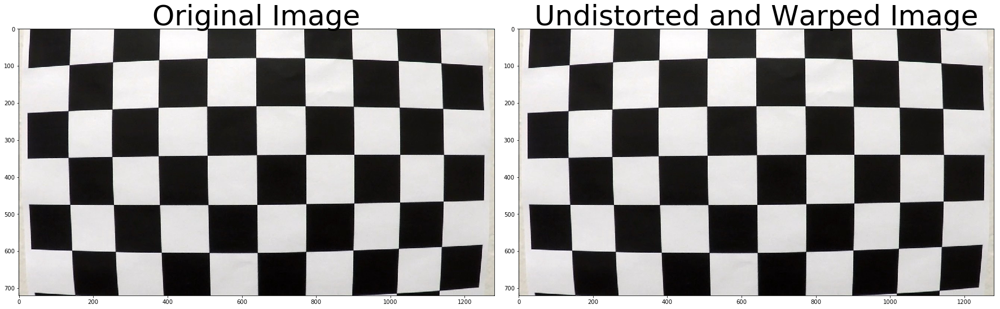

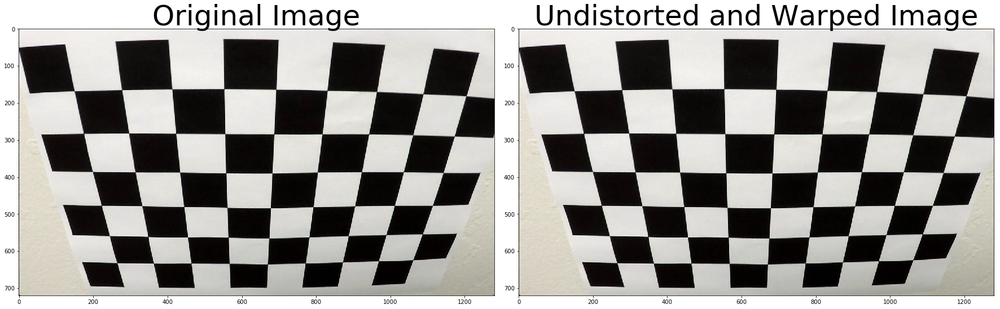

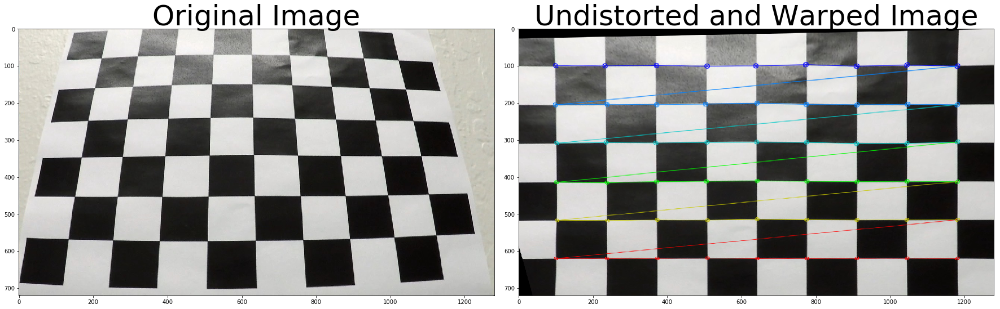

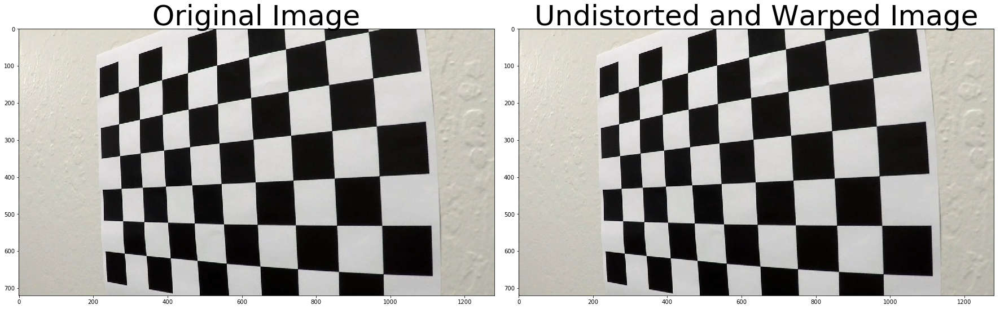

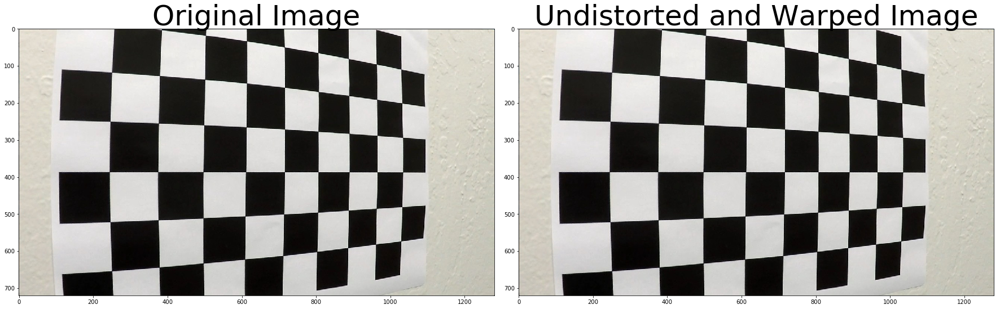

In [29]:
# transform image perspective
def corners_unwarp(img):
    
    # Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert to grayscale
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)
#     cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
    warped, M, Minv = img,None,None
    if ret:
        cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
        img_size = gray.shape[::-1]
        offset = 100
        src = np.float32([corners[0],corners[cb_col-1],corners[-1],corners[-cb_col]])
        # define 4 destination points                
        dst = np.float32([[offset,offset],
                          [img_size[0]-offset,offset],
                          [img_size[0]-offset,img_size[1]-offset],
                          [offset,img_size[1]-offset]])
        # get M and Minv, the transform matrix and the inverse matrix
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst,src)
        # warp image to a top-down view
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

for image in images:    
    test_img = mpimg.imread(image)  
    top_down, perspective_M, perspective_Minv = corners_unwarp(test_img)
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=50)
    
    ax2.imshow(top_down)
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

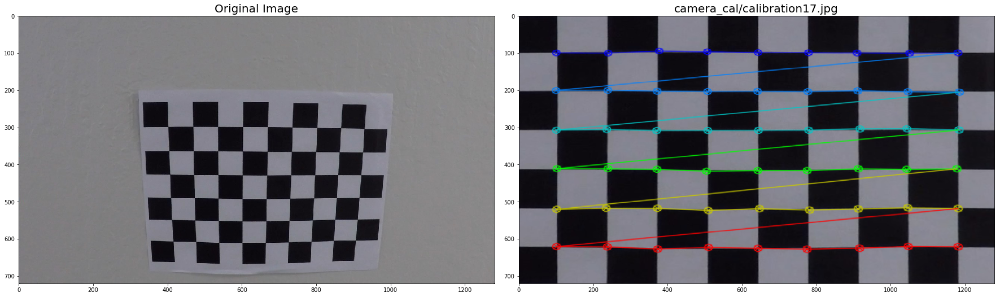

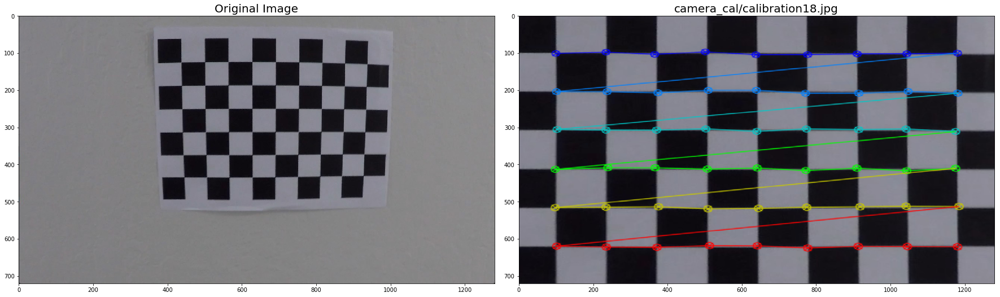

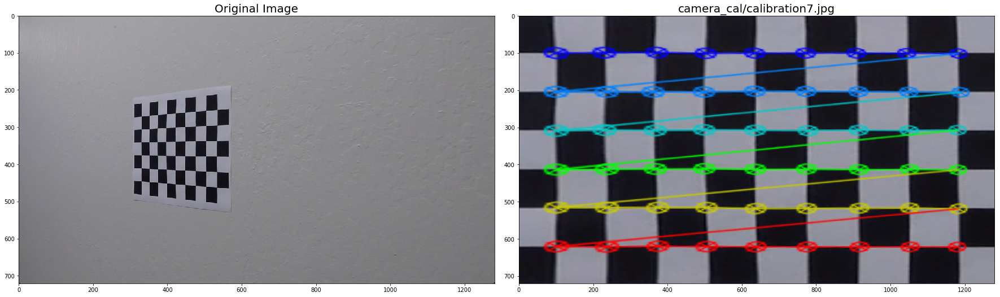

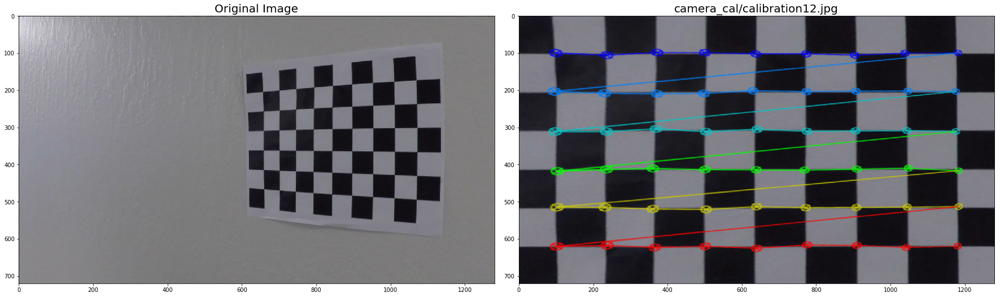

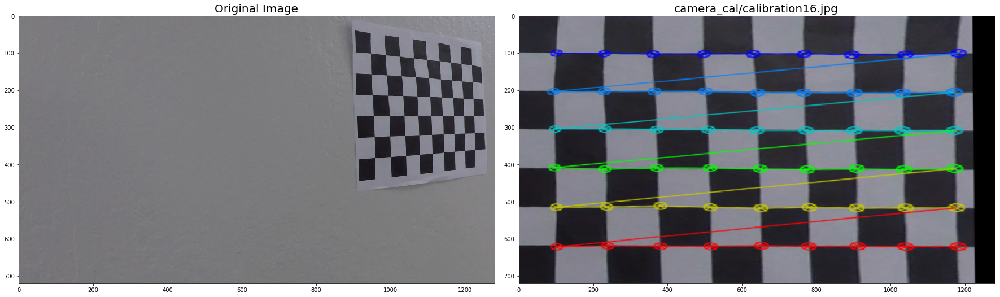

...

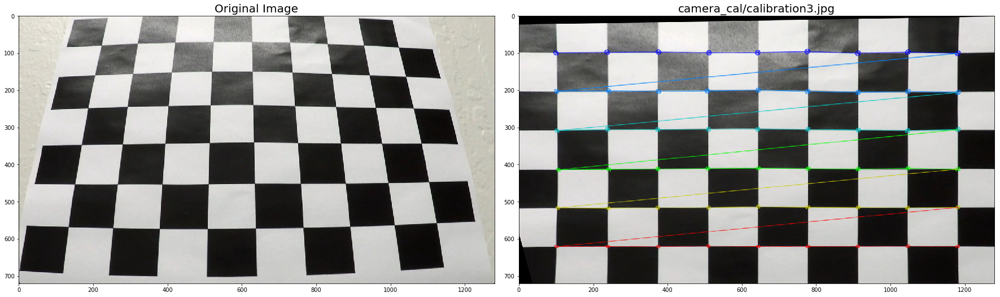

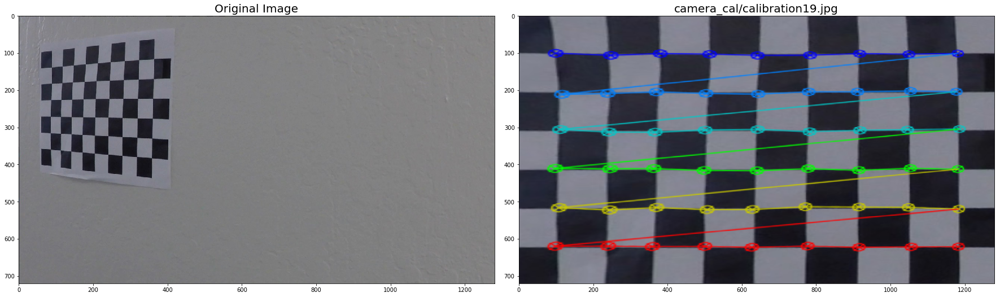

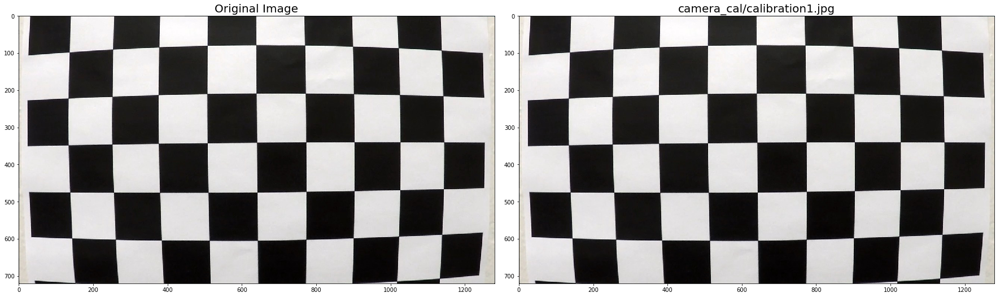

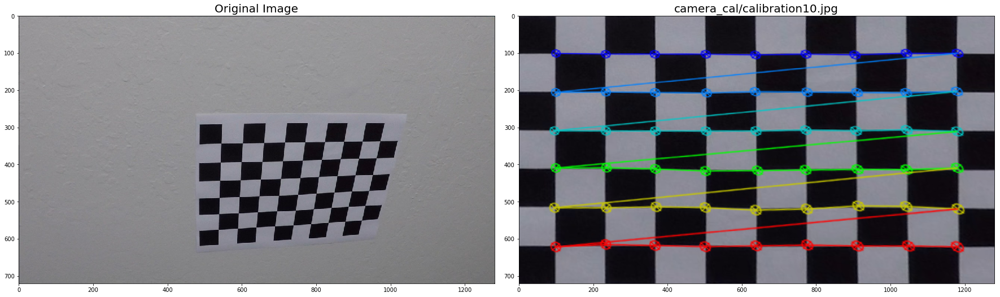

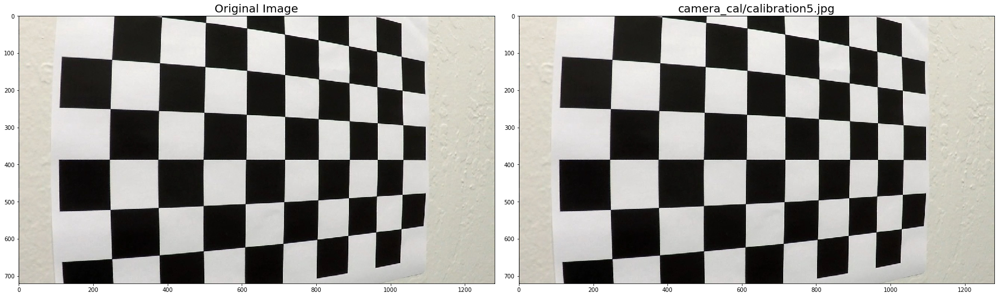

In [17]:
import glob
# %matplotlib qt

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# get image size
image_cali = mpimg.imread(images[0])  
img_size = image_cali.shape[1::-1]

# # arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# # prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        
#use obtained object points and image points to calibrate camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,img_size, None, None)

def camera_calibrate(img = None,mtx = None, dist=None):
    
#     img = np.copy(image)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # convert to grayscale image
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim, None)

    # use calibrated camera mtx, dist to undistort raw image
    warped, M, Minv = img,None,None
    
    if ret == True:    
        # if found, draw corners on chessboard
        cv2.drawChessboardCorners(undist, chessboard_dim, corners, ret)
        
        offset = 100
        
        src = np.float32([corners[0],corners[cb_col-1],corners[-1],corners[-cb_col]])
        # define 4 destination points                
        dst = np.float32([[offset,offset],
                          [img_size[0]-offset,offset],
                          [img_size[0]-offset,img_size[1]-offset],
                          [offset,img_size[1]-offset]])
        # get M and Minv, the transform matrix and the inverse matrix
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst,src)
        # warp image to a top-down view
        warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv


# images = ['camera_cal/calibration1.jpg','camera_cal/calibration2.jpg','camera_cal/calibration3.jpg',
#           'camera_cal/calibration4.jpg','camera_cal/calibration5.jpg']
for image in images:    
    test_img = mpimg.imread(image) 
    top_down, perspective_M, perspective_Minv = camera_calibrate(test_img,mtx,dist)
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=20)
    
    ax2.imshow(top_down)
    ax2.set_title(image, fontsize=20)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


** We see that most of input images are well undistorted and transformed for perspective except for four of them,however this is enough for calibrating the camera, so we move to next. **

## 2. Pipeline (single images)


### 2.1. Provide an example of a distortion-corrected image.

To demonstrate this step, I will describe how I apply the distortion correction to one of the test images like this one:

In [2]:
import glob
# %matplotlib qt

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# get image size
image_cali = mpimg.imread(images[0])  
img_size = image_cali.shape[1::-1]

# # arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# # prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        
#use obtained object points and image points to calibrate camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,img_size, None, None)

In [3]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def pipeline(img, s_thresh=(170, 255), sx_thresh=(30, 100)):
    img = np.copy(img)
    
    # undistort image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS).astype(np.float)
#     l_channel = hls[:,:,1]
    # l_channel = img[:,:,0]
    s_channel = hls[:,:,2]
    
    # grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
    
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[((s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1]))| ((scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1]))] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary), np.zeros_like(sxbinary), s_binary))
    
    return s_binary*255

def perspective_transform(img = None,src = None,dst = None):
    
    # use calibrated camera mtx, dist to undistort raw image
    warped, M, Minv = img,None,None

    # get M and Minv, the transform matrix and the inverse matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    # warp image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

example_images = glob.glob('test_images/*.jpg')

# # for frame in example_images:
imshape = image_cali.shape
# test_img = mpimg.imread('test_images/straight_lines1.jpg') 
vertices = np.array([[(imshape[1]*0.1,imshape[0]-1),
                      (imshape[1]*0.45, imshape[0]*0.6), 
                      (imshape[1]*0.55, imshape[0]*0.6),
                      (imshape[1]*0.95,imshape[0]-1)]],
                    dtype=np.int32)

# result = pipeline(test_img)

src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])

# vert = vertices[0]

# for frame in example_images:
#     # for frame in example_images:
#     test_img = mpimg.imread(frame) 

#     result = pipeline(test_img)
#     masked_edges = region_of_interest(result,vertices)
#     top_down, perspective_M, perspective_Minv = perspective_transform(masked_edges,src,dst)

#     # Plot the result
#     f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
#     f.tight_layout()

#     ax1.imshow(test_img)
#     ax1.set_title('Original Image', fontsize=16)
    
#     cv2.line(result,(vert[0][0],vert[0][1]),(vert[1][0],vert[1][1]), [255, 255, 255], 3)
#     cv2.line(result,(vert[1][0],vert[1][1]),(vert[2][0],vert[2][1]), [255, 255, 255], 3)
#     cv2.line(result,(vert[2][0],vert[2][1]),(vert[3][0],vert[3][1]), [255, 255, 255], 3)
    
#     ax2.imshow(result,cmap='gray')
#     ax2.set_title('Pipeline Result', fontsize=16)

#     ax3.imshow(masked_edges,cmap='gray')
#     ax3.set_title('Masked Result', fontsize=16)

# #     cv2.line(top_down,(dst[0][0],dst[0][1]),(dst[1][0],dst[1][1]), [1, 1, 1], 3)
# #     cv2.line(top_down,(dst[1][0],dst[1][1]),(dst[2][0],dst[2][1]), [1, 1, 1], 3)
# #     cv2.line(top_down,(dst[2][0],dst[2][1]),(dst[3][0],dst[3][1]), [1, 1, 1], 3)
    
#     ax4.imshow(top_down,cmap='gray')
#     ax4.set_title('Top_down Result', fontsize=16)
#     plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 2.2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image.  Provide an example of a binary image result.

I used a combination of color and gradient thresholds to generate a binary image (thresholding steps at lines # through # in `another_file.py`).  Here's an example of my output for this step.  (note: this is not actually from one of the test images)

### 2.3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

The code for my perspective transform includes a function called `warper()`, which appears in lines 1 through 8 in the file `example.py` (output_images/examples/example.py) (or, for example, in the 3rd code cell of the IPython notebook).  The `warper()` function takes as inputs an image (`img`), as well as source (`src`) and destination (`dst`) points.  I chose the hardcode the source and destination points in the following manner:

```python
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])
```

This resulted in the following source and destination points:

| Source        | Destination   | 
|:-------------:|:-------------:| 
| 585, 460      | 320, 0        | 
| 203, 720      | 320, 720      |
| 1127, 720     | 960, 720      |
| 695, 460      | 960, 0        |

I verified that my perspective transform was working as expected by drawing the `src` and `dst` points onto a test image and its warped counterpart to verify that the lines appear parallel in the warped image.

![alt text][image4]

In [ ]:
#TODO

### 2.4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

Then I did some other stuff and fit my lane lines with a 2nd order polynomial kinda like this:

![alt text][image5]

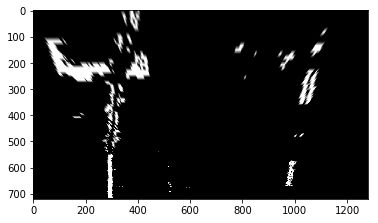

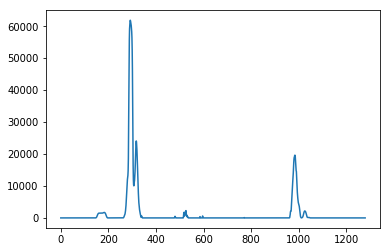

In [4]:
# extract lane lines out of original image
def get_transformed_lane_lines(img = None):
    result = pipeline(img)
    masked_edges = region_of_interest(result,vertices)
    top_down, perspective_M, perspective_Minv = perspective_transform(masked_edges,src,dst)
    return perspective_transform(masked_edges,src,dst)

test_img = mpimg.imread(example_images[4]) 
img,_,_= get_transformed_lane_lines(test_img)
plt.imshow(img,cmap='gray')
plt.show()
# img=img*255
histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
plt.plot(histogram)


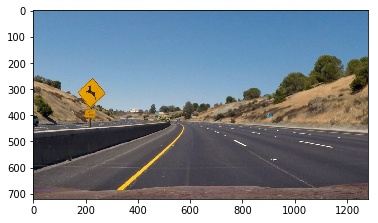

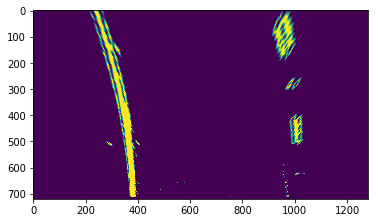

(720, 1280, 3)


(720, 0)

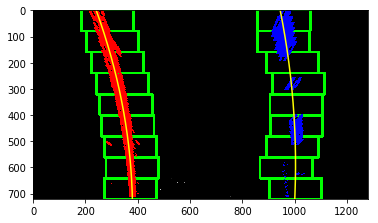

In [6]:
test_img = mpimg.imread(example_images[5]) 
plt.imshow(test_img)
plt.show()

binary_warped,M,Minv= get_transformed_lane_lines(test_img)
plt.imshow(binary_warped/255)
plt.show()

# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))

# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint


# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base

# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# get nonzeros points
def get_nonzeros(window=0):
        # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 10) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 10) 
    
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                      (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                       (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    return good_left_inds,good_right_inds


# Step through the windows one by one
for window in range(nwindows):
    good_left_inds,good_right_inds = get_nonzeros(window)
    
    # try to find enough points for left lane line
    enough_left = len(good_left_inds) > minpix
    while(not enough_left):
        # increase searching window size
        margin += 10
        # try another time
        good_left_inds,_ = get_nonzeros(window)
        # if found or the window is too large then jump out and use the current found points
        if len(good_left_inds) > minpix or margin >= 150:
            enough_left = True
            
    # Append left indices to the list
    left_lane_inds.append(good_left_inds)  
    # resize window size 
    margin = 100
    
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

    # try to find enough points for right lane line
    enough_right = len(good_right_inds) > minpix
    while(not enough_right):
        # increase searching window size
        margin += 10
        # try another time
        _,good_right_inds = get_nonzeros(window)
        # if found or the window is too large then jump out and use the current found points
        if len(good_right_inds) > minpix or margin >= 150:
            enough_right = True
            
    # Append right indices to the list
    right_lane_inds.append(good_right_inds)  
    # resize window size 
    margin = 100
            
    if len(good_right_inds) > minpix:  
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
print(out_img.shape)
plt.imshow(out_img/255)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

### 2.5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

I did this in lines # through # in my code in `my_other_file.py`


In [12]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')

696.620165474 m 972.492516664 m


### keep track on parameters ###

In [13]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

In [15]:
left_line = Line()
right_line = Line()

### 2.6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

I implemented this step in lines # through # in my code in `yet_another_file.py` in the function `map_lane()`.  Here is an example of my result on a test image:

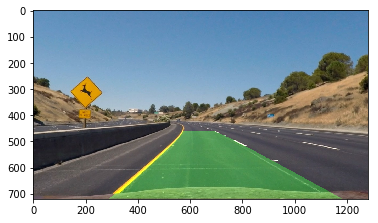

In [17]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
undist = cv2.undistort(test_img, mtx, dist, None, mtx)
# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

In [49]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
%matplotlib inline

# read in all images and store in an array
images = glob.glob('camera_cal/calibration*.jpg')

# chessboard cols and rows number
cb_col,cb_row = 9,6
chessboard_dim = (cb_col,cb_row)

# get image size
image_cali = mpimg.imread(images[0])  
img_size = image_cali.shape[1::-1]

# arrays to store object points in 3D and image points in 2D
objpoints = [] # 3D points in real world space 
imgpoints = [] # 2D points in image plane

# prepare object points, like (0,0,0),(1,0,0)...
objp = np.zeros((cb_row*cb_col,3),np.float32)
objp[:,:2] = np.mgrid[0:cb_col,0:cb_row].T.reshape(-1,2) # x,y coordinates

# iterate over all images and fill in objpoints and imgpoints
for frame in images:
    # read in each image
    image = mpimg.imread(frame)
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_dim)    
    # if corners are found, add object points and image points
    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)
        
#use obtained object points and image points to calibrate camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,img_size, None, None)


def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def sobelx_color_threshold(img, s_thresh=(170, 255), sx_thresh=(30, 100)):
    img = np.copy(img)
    
    # undistort image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(undist, cv2.COLOR_RGB2HLS).astype(np.float)
#     l_channel = hls[:,:,1]
    # l_channel = img[:,:,0]
    s_channel = hls[:,:,2]
    
    # grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
    
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel and  x gradient
    s_binary = np.zeros_like(s_channel)
    s_binary[((s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1]))| ((scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1]))] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
#     color_binary = np.dstack(( np.zeros_like(sxbinary), np.zeros_like(sxbinary), s_binary))
    
    return s_binary*255,undist

def perspective_transform(img = None,src = None,dst = None):
    
    # use calibrated camera mtx, dist to undistort raw image
    warped, M, Minv = img,None,None

    # get M and Minv, the transform matrix and the inverse matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    # warp image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv

# image shape
imshape = image_cali.shape
# vertices for interest region mask
vertices = np.array([[(imshape[1]*0.1,imshape[0]-1),
                      (imshape[1]*0.45, imshape[0]*0.6), 
                      (imshape[1]*0.55, imshape[0]*0.6),
                      (imshape[1]*0.95,imshape[0]-1)]],
                    dtype=np.int32)

# points in original image to project
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
# points projecting to destination image
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = np.array([0,0,0], dtype='float')   
        #radius of curvature of the line in  km
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

# track for left line
left_line = Line()
# track for left line
right_line = Line()

# keep last n records
keep_max = 10

# max tolerant deviation from last average position
max_dev = 30

# Choose the number of sliding windows
nwindows = 9

# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720000 # kilometers per pixel in y dimension
xm_per_pix = 3.7/700000 # kilometers per pixel in x dimension

# Define lane line coefficients
left_fit = None
right_fit = None

# get nonzeros points
def get_nonzeros(binary_warped = None,
                 out_img = None, 
                 window_height = 0, 
                 leftx_current = 0,
                 rightx_current = 0,
                 window=0,
                 nonzerox=None,
                 nonzeroy=None,
                 margin = 100):
        # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 10) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 10) 
    
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                      (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                       (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    return good_left_inds,good_right_inds

In [62]:
# max tolerant deviation from last average position
max_dev = 20
# flag indicating if need calculate lane lines base from histogram
cal_lane_from_hist = True
def pipeline(image = None):
    
    sobelx_color,undist = sobelx_color_threshold(image)
    masked_edges = region_of_interest(sobelx_color,vertices)
    binary_warped, M, Minv = perspective_transform(masked_edges,src,dst)
        # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])


    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Set the width of the windows +/- margin
    margin = 100
    # arrays for detected left lane indexes and right lane indexes
    left_lane_inds, right_lane_inds = [],[]

    # If lane line not detected last time for either track, then restart blind search
    if cal_lane_from_hist:
                # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
            # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Step through the windows one by one
        for window in range(nwindows):
            good_left_inds,good_right_inds = get_nonzeros(binary_warped = binary_warped,
                                                            out_img = out_img,
                                                            window_height = window_height, 
                                                            leftx_current = leftx_current,
                                                            rightx_current = rightx_current,
                                                            window=window,
                                                            nonzerox=nonzerox,
                                                            nonzeroy=nonzeroy,
                                                            margin=margin)
            
            # try to find enough points for left lane line
            enough_left = len(good_left_inds) > minpix
            while(not enough_left):
                # increase searching window size
                margin += 10
                # try another time
                good_left_inds,_ = get_nonzeros(binary_warped = binary_warped, 
                                                            out_img=out_img,
                                                            window_height = window_height, 
                                                            leftx_current = leftx_current,
                                                            rightx_current = rightx_current,
                                                            window=window,
                                                            nonzerox=nonzerox,
                                                            nonzeroy=nonzeroy,
                                                            margin=margin)
                # if found or the window is too large then jump out and use the current found points
                if len(good_left_inds) > minpix or margin >= 150:
                    enough_left = True
                    
            # Append left indices to the list
            left_lane_inds.append(good_left_inds)  
            # resize window size 
            margin = 100
            
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

            # try to find enough points for right lane line
            enough_right = len(good_right_inds) > minpix
            while(not enough_right):
                # increase searching window size
                margin += 10
                # try another time
                _,good_right_inds = get_nonzeros(binary_warped = binary_warped, 
                                                            out_img=out_img,
                                                            window_height = window_height, 
                                                            leftx_current = leftx_current,
                                                            rightx_current = rightx_current,
                                                            window=window,
                                                            nonzerox=nonzerox,
                                                            nonzeroy=nonzeroy,
                                                            margin=margin)
                # if found or the window is too large then jump out and use the current found points
                if len(good_right_inds) > minpix or margin >= 150:
                    enough_right = True
                    
            # Append right indices to the list
            right_lane_inds.append(good_right_inds)  
            # resize window size 
            margin = 100
                    
            if len(good_right_inds) > minpix:  
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    else:
        left_lane_inds = ((nonzerox > (left_line.current_fit[0]*(nonzeroy**2) + left_line.current_fit[1]*nonzeroy + 
        left_line.current_fit[2] - margin)) & (nonzerox < (left_line.current_fit[0]*(nonzeroy**2) + 
        left_line.current_fit[1]*nonzeroy + left_line.current_fit[2] + margin))) 

        right_lane_inds = ((nonzerox > (right_line.current_fit[0]*(nonzeroy**2) + right_line.current_fit[1]*nonzeroy + 
        right_line.current_fit[2] - margin)) & (nonzerox < (right_line.current_fit[0]*(nonzeroy**2) + 
        right_line.current_fit[1]*nonzeroy + right_line.current_fit[2] + margin)))  
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # update tracking class parameter
    left_line.diffs = np.absolute(left_fit - left_line.current_fit)
        
    right_line.diffs = np.absolute(right_fit - right_line.current_fit)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    # Calculate 
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # update tracking class parameters
    left_line.radius_of_curvature = left_curverad
    right_line.radius_of_curvature = right_curverad

    # base x-position of left lane line
    left_base_pos  = np.absolute(left_fit[0]*(y_eval*ym_per_pix*1000)**2+left_fit[1]*y_eval*ym_per_pix*1000+left_fit[0])
    # base x-position of left lane line
    right_base_pos = np.absolute(right_fit[0]*(y_eval*ym_per_pix*1000)**2+right_fit[1]*y_eval*ym_per_pix*1000+right_fit[0])

    left_line.line_base_pos = img_size[0]/2*xm_per_pix*1000-(left_base_pos+right_base_pos)/2

    # Get current left lane line base position
    left_base_P = np.absolute(left_fit[0]*(y_eval)**2+left_fit[1]*y_eval+left_fit[0])
    if left_line.diffs > max_dev:# if fitted list deviation exceeds threshold
        # detection failed
        left_line.detected = False
        # use last fitted coefficients and points
        left_fit = left_line.left_fit
        leftx=left_line.leftx
        lefty=left_line.leftx
    else: # or this detection is acceptable
        #then update current tracked parameters
        left_line.left_fit = left_fit
        left_line.bestx = left_base_P
        left_line.detected = True
        
    # add detection result to tracking list
    left_line.recent_xfitted.append(left_line.detected)
    # if tracking list exceeds max size then delete least recently added 
    if len(left_line.recent_xfitted) > keep_max:
        del left_line.recent_xfitted[0]
    
    # if bad detection exceeds 30%, then recalculate base positions in next frame    
    if sum(left_line.recent_xfitted)/len(left_line.recent_xfitted) > 0.3:
        cal_lane_from_hist = True
        print('Left lane deviated')
    else:
        cal_lane_from_hist = False
        # calculate average x for left line
#         left_line.bestx = np.mean(left_line.recent_xfitted)  

    # Get current right lane line base position
    right_base_P = np.absolute(right_fit[0]*(y_eval)**2+right_fit[1]*y_eval+right_fit[0])

#     if len(right_line.recent_xfitted) > 0:
#         if np.absolute(right_base_P - np.mean(right_line.recent_xfitted)) > max_dev:
#             right_line.detected = False
#             print('Right lane deviated')
#         else:
#             right_line.detected = True
#             right_line.recent_xfitted.append(right_base_P)
#             # if list exceeds max size then delete first element
#             if len(right_line.recent_xfitted) > keep_max:
#                 del right_line.recent_xfitted[0]
#             # update average x for left line
#             right_line.bestx = np.mean(right_line.recent_xfitted)
#     else:
#         right_line.recent_xfitted.append(right_base_P)
#         right_line.bestx = right_base_P
#         right_line.detected = True
    if right_line.diffs > max_dev:# if fitted list deviation exceeds threshold
        # detection failed
        right_line.detected = False
        # use last fitted coefficients and points
        right_fit = right_line.current_fit
        rightx=right_line.allx
        righty=right_line.ally
    else: # or this detection is acceptable
        #then update current tracked parameters
        right_line.current_fit = right_fit
        right_line.bestx = left_base_P
        right_line.detected = True
        
    # add detection result to tracking list
    right_line.recent_xfitted.append(right_line.detected)
    # if tracking list exceeds max size then delete least recently added 
    if len(right_line.recent_xfitted) > keep_max:
        del right_line.recent_xfitted[0]
    
    # if bad detection exceeds 30%, then recalculate base positions in next frame    
    if sum(right_line.recent_xfitted)/len(right_line.recent_xfitted) > 0.3:
        cal_lane_from_hist = True
    else:
        cal_lane_from_hist = False and cal_lane_from_hist
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)

    cv2.putText(result, 'Left lane radius : {0:.3f} km'.format(left_line.radius_of_curvature), (int(img_size[0]/4),30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_4)
    cv2.putText(result, 'Right lane radius: {0:.3f} km'.format(right_line.radius_of_curvature), (int(img_size[0]/4),60), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_4)
    cv2.putText(result, 'Deviation from line: {0:.1f} m'.format(left_line.line_base_pos), (int(img_size[0]/4),90), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_4)
    cv2.putText(result, 'Left lane diffs : {0:.3f}'.format(np.sum(left_line.diffs)), (int(img_size[0]/4),120), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_4)
    cv2.putText(result, 'Right lane diffs: {0:.3f}'.format(np.sum(right_line.diffs)), (int(img_size[0]/4),150), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_4)

    return result

SyntaxError: invalid syntax (<ipython-input-62-24dd3ec8cc1d>, line 173)

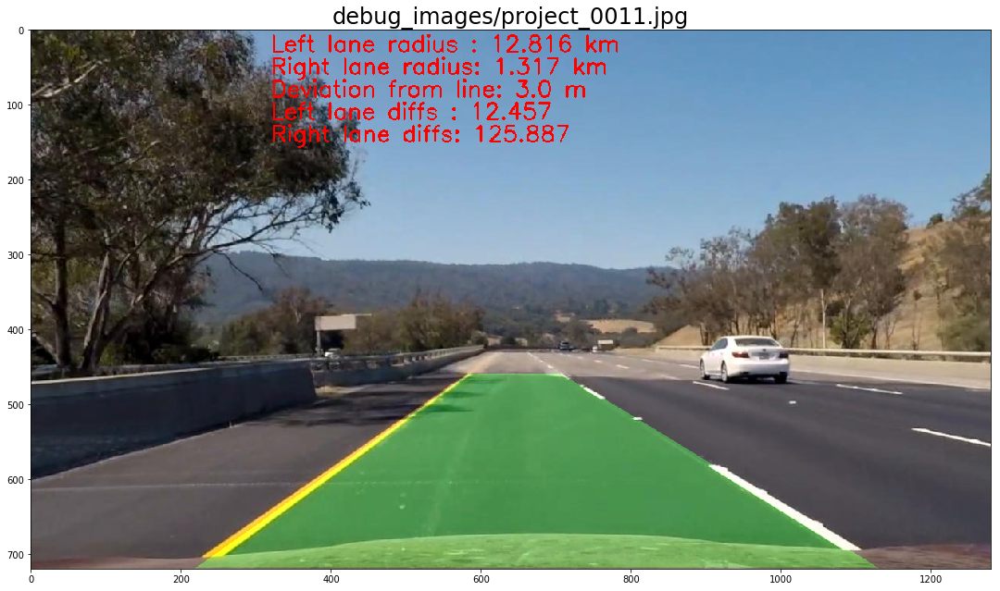

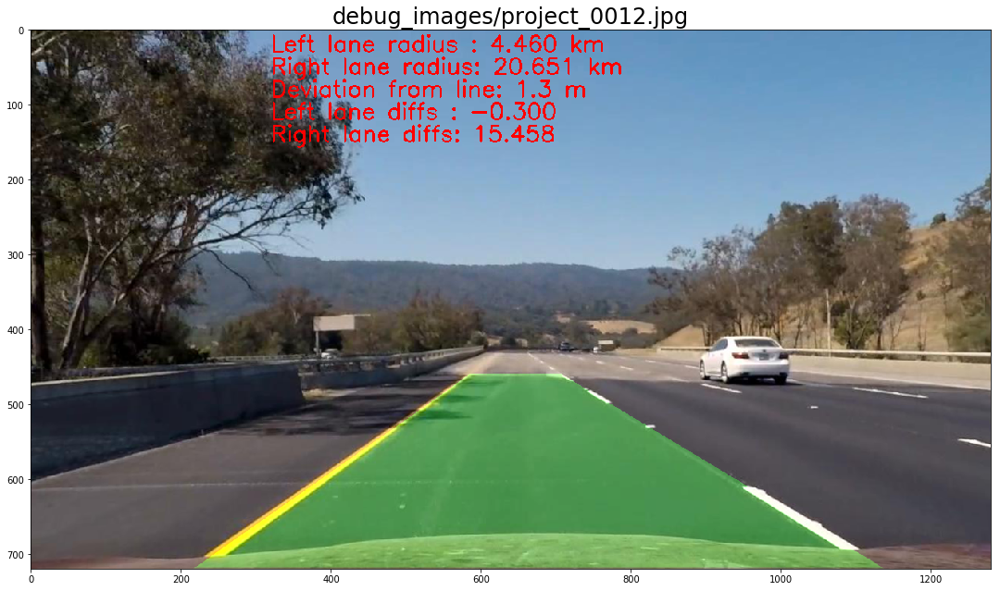

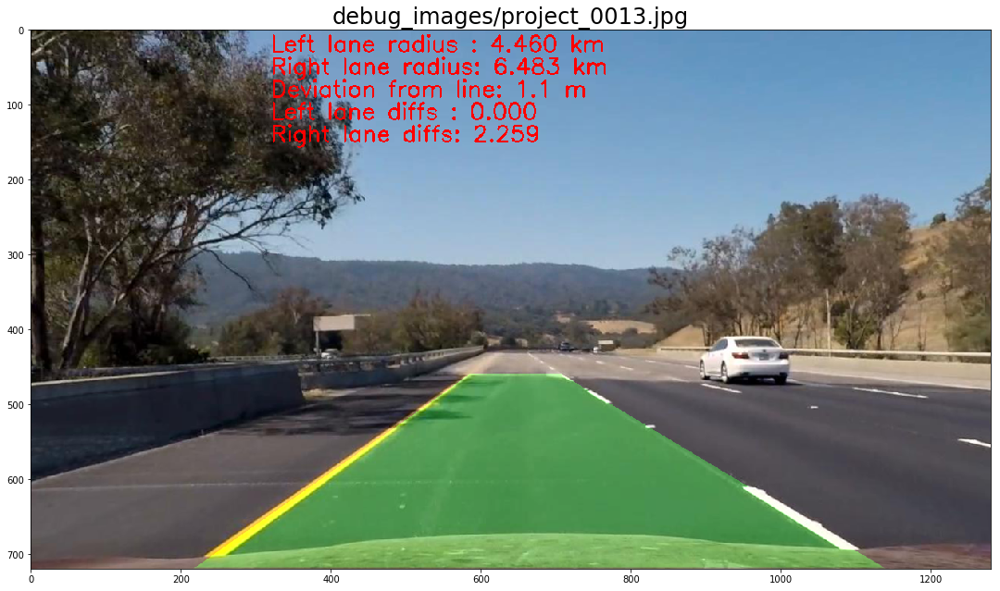

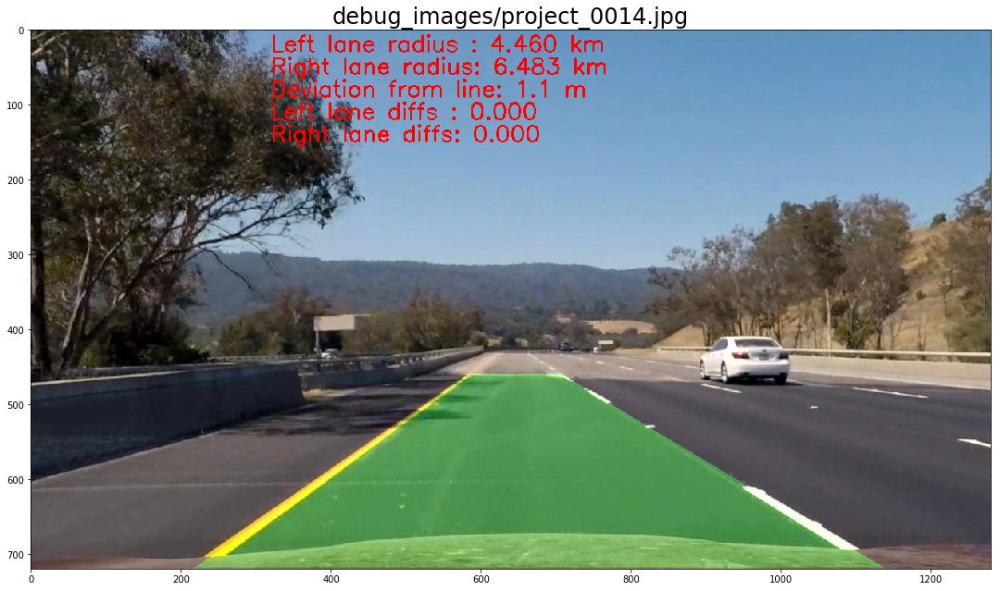

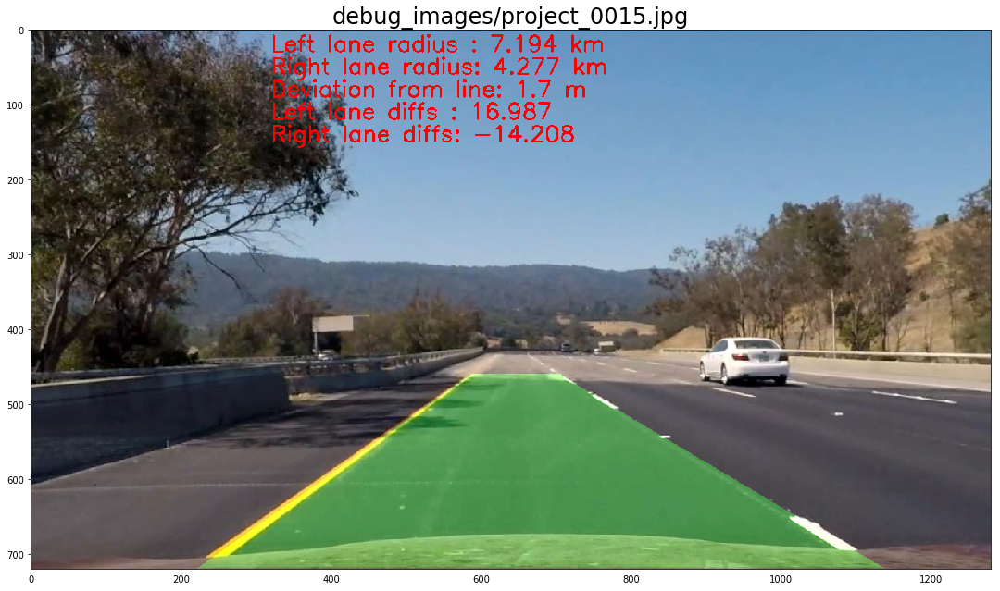

...

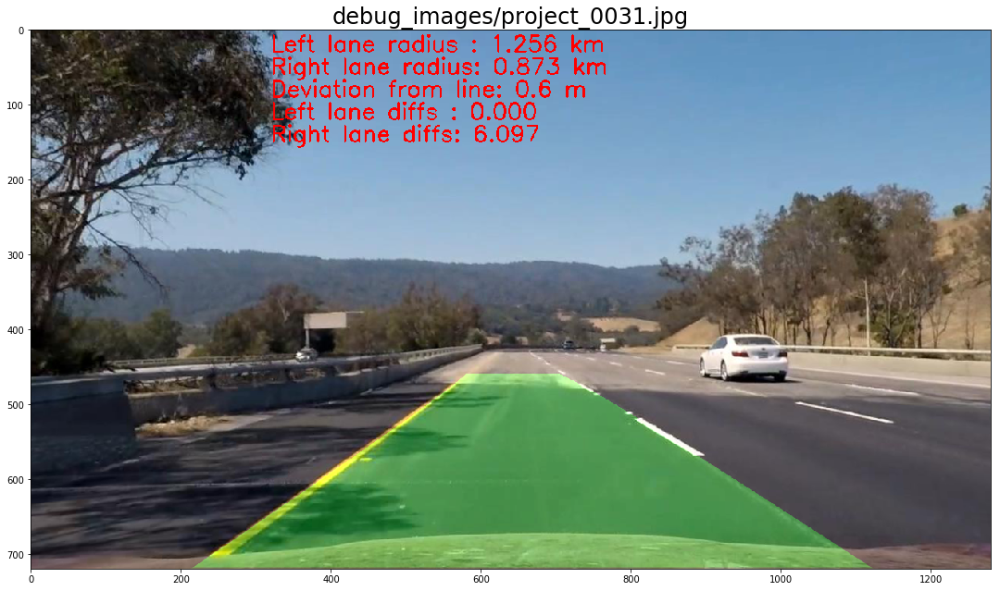

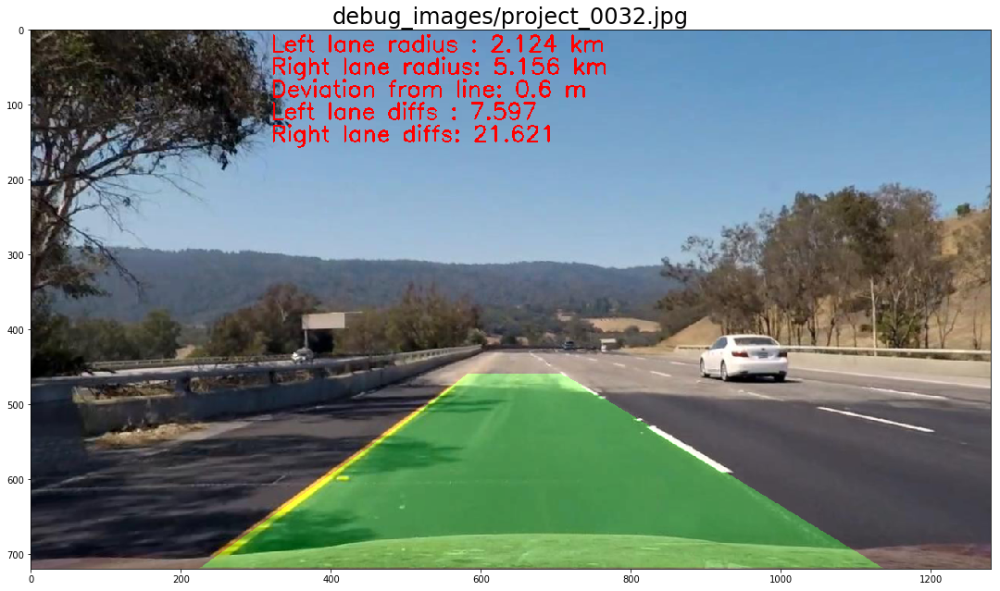

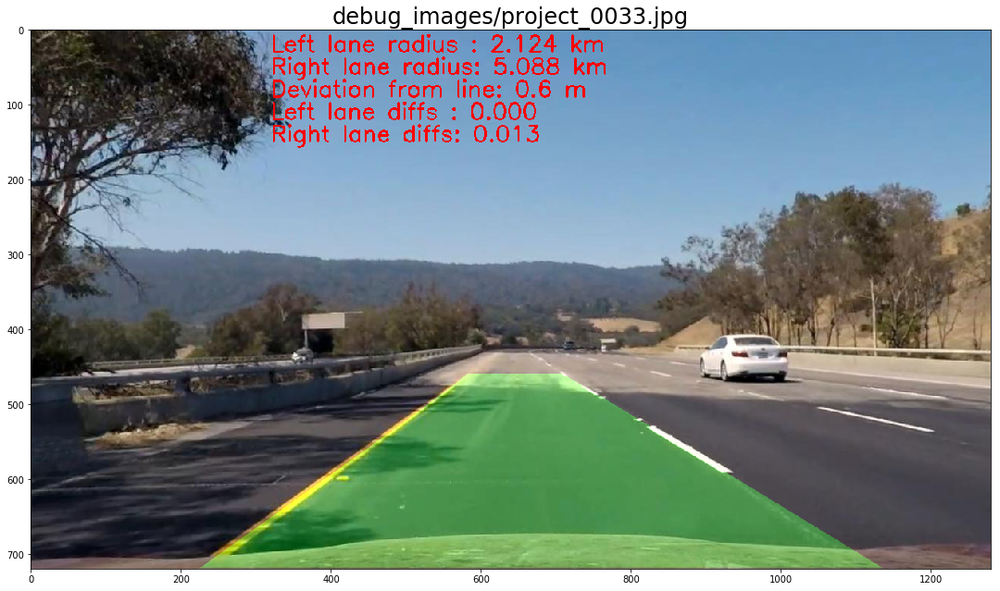

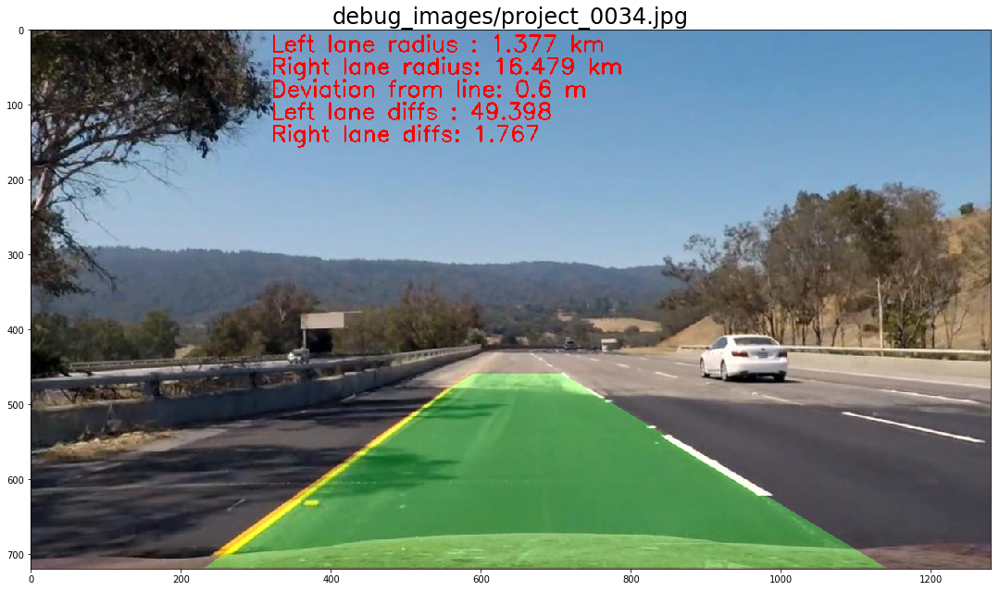

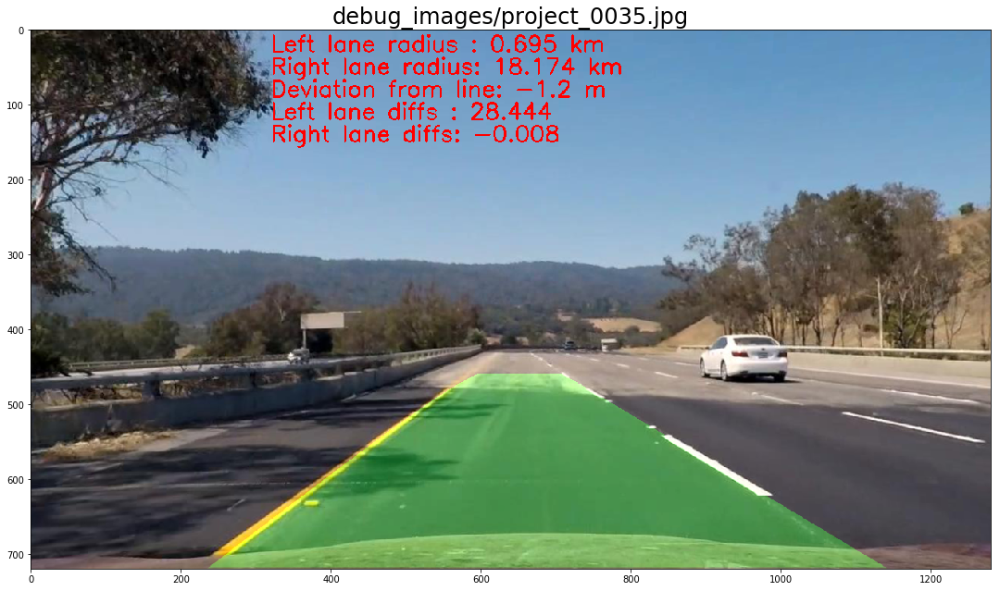

In [61]:
# example_images = glob.glob('debug_images/*.jpg')
example_images = []
for i in range(11,36):
    example_images.append('debug_images/project_00'+str(i)+'.jpg')

for frame in example_images:
    test_img = mpimg.imread(frame) 
    result = pipeline(test_img)
     # Plot the result
    f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(result)
    ax1.set_title(frame, fontsize=24)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 3. Pipeline (video)

#### 1. Provide a link to your final video output.  Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).

Here's a [link to my video result](./project_video.mp4)

In [35]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import os

In [36]:
white_output = 'test_video/output_project_video.mp4'
clip1 = VideoFileClip("test_video/project_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(os.path.join(white_output), audio=False)

[MoviePy] >>>> Building video test_video/output_project_video.mp4
[MoviePy] Writing video test_video/output_project_video.mp4


100%|█████████▉| 1260/1261 [03:59<00:00,  5.59it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_video/output_project_video.mp4 

CPU times: user 8min 26s, sys: 1.47 s, total: 8min 28s
Wall time: 4min


### Visualize generated video ###

In [37]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

## Capture frames failing on detection ##

In [55]:
clip1 = VideoFileClip("test_video/project_video.mp4").subclip(21,22)
clip1.write_images_sequence('debug_images/project_%04d.jpg', fps=60)

[MoviePy] Writing frames debug_images/project_%04d.jpg.

60it [00:01, 32.18it/s]              

[MoviePy]: Done writing frames debug_images/project_%04d.jpg.



['debug_images/project_0000.jpg',
 'debug_images/project_0001.jpg',
 'debug_images/project_0002.jpg',
 'debug_images/project_0003.jpg',
 'debug_images/project_0004.jpg',
 'debug_images/project_0005.jpg',
 'debug_images/project_0006.jpg',
 'debug_images/project_0007.jpg',
 'debug_images/project_0008.jpg',
 'debug_images/project_0009.jpg',
 'debug_images/project_0010.jpg',
 'debug_images/project_0011.jpg',
 'debug_images/project_0012.jpg',
 'debug_images/project_0013.jpg',
 'debug_images/project_0014.jpg',
 'debug_images/project_0015.jpg',
 'debug_images/project_0016.jpg',
 'debug_images/project_0017.jpg',
 'debug_images/project_0018.jpg',
 'debug_images/project_0019.jpg',
 'debug_images/project_0020.jpg',
 'debug_images/project_0021.jpg',
 'debug_images/project_0022.jpg',
 'debug_images/project_0023.jpg',
 'debug_images/project_0024.jpg',
 'debug_images/project_0025.jpg',
 'debug_images/project_0026.jpg',
 'debug_images/project_0027.jpg',
 'debug_images/project_0028.jpg',
 'debug_images

### 4. Discussion

#### 1. Briefly discuss any problems / issues you faced in your implementation of this project.  Where will your pipeline likely fail?  What could you do to make it more robust?

Here I'll talk about the approach I took, what techniques I used, what worked and why, where the pipeline might fail and how I might improve it if I were going to pursue this project further.  